## geopandas for GIS-folk 2

Åpne heller notebook-en her:

https://nbviewer.org/github/statisticsnorway/intro_til_geopandas/blob/main/4_geopandas_for_GIS_2.ipynb

Notebook-en kan kjøres i dapla hvis du har tilgang til kartdataene.

### Hva er geopandas?

Geopandas er en python-pakke ala arcpy og pyqgis.

GIS-biten er basert på de samme algoritmene som i QGIS, POSTGIS osv.

Det som ikke har med GIS å gjøre er basert på pakken pandas. 

Alt man kan gjøre i pandas, kan man også gjøre i geopandas. Pluss GIS. 

## geopandas

In [1]:
import geopandas as gpd

I geopandas starter man med å lese inn dataene sine som en GeoDataFrame.

Siden dette er dapla, må man gjennom sikkerhetsmuren. 

For eksempel via funksjonen sgis.read_geopandas:

In [2]:
import sgis as sg

In [3]:
n5000_kommunesti = "ssb-prod-kart-data-delt/kartdata_visualisering/klargjorte-data/2022/parquet/N5000_kommune_flate_p2022_v1.parquet"

kommuner = sg.read_geopandas(n5000_kommunesti)

kommuner

,OBJTYPE,NAVN,KOMMUNENR,SHAPE_Length,SHAPE_Area,geometry
0,Kommune,Alstahaug,1820,126623.728536,1.542645e+08,"MULTIPOLYGON (((393031.130 7322897.000, 392431..."
1,Kommune,Alta,5403,605644.767959,3.742475e+09,"MULTIPOLYGON (((827951.920 7819380.820, 830139..."
2,Kommune,Alvdal,3428,144895.626627,9.325153e+08,"MULTIPOLYGON (((284645.390 6883576.450, 285460..."
3,Kommune,Alver,4631,260175.662937,5.856690e+08,"MULTIPOLYGON (((-26068.640 6771499.000, -25768..."
4,Kommune,Andøy,1871,181307.687722,6.771995e+08,"MULTIPOLYGON (((522790.800 7645784.410, 519366..."
...,...,...,...,...,...,...
351,Kommune,Åmot,3422,180392.070296,1.329674e+09,"MULTIPOLYGON (((324711.900 6789915.870, 323070..."
352,Kommune,Årdal,4643,164129.187065,9.724066e+08,"MULTIPOLYGON (((134985.300 6829515.790, 134926..."
353,Kommune,Ås,3021,50204.661912,9.761353e+07,"MULTIPOLYGON (((267648.620 6616156.810, 266978..."
354,Kommune,Åseral,4224,126242.804001,8.933625e+08,"MULTIPOLYGON (((74731.020 6533507.960, 74632.4..."


Velger ut kolonner:

In [4]:
kommuner = kommuner[["KOMMUNENR", "geometry"]]
kommuner

,KOMMUNENR,geometry
0,1820,"MULTIPOLYGON (((393031.130 7322897.000, 392431..."
1,5403,"MULTIPOLYGON (((827951.920 7819380.820, 830139..."
2,3428,"MULTIPOLYGON (((284645.390 6883576.450, 285460..."
3,4631,"MULTIPOLYGON (((-26068.640 6771499.000, -25768..."
4,1871,"MULTIPOLYGON (((522790.800 7645784.410, 519366..."
...,...,...
351,3422,"MULTIPOLYGON (((324711.900 6789915.870, 323070..."
352,4643,"MULTIPOLYGON (((134985.300 6829515.790, 134926..."
353,3021,"MULTIPOLYGON (((267648.620 6616156.810, 266978..."
354,4224,"MULTIPOLYGON (((74731.020 6533507.960, 74632.4..."


### Geometrikolonnen
name: geometry

dtype (datatype): geometry

In [5]:
kommuner.geometry

0      MULTIPOLYGON (((393031.130 7322897.000, 392431...
1      MULTIPOLYGON (((827951.920 7819380.820, 830139...
2      MULTIPOLYGON (((284645.390 6883576.450, 285460...
3      MULTIPOLYGON (((-26068.640 6771499.000, -25768...
4      MULTIPOLYGON (((522790.800 7645784.410, 519366...
                             ...                        
351    MULTIPOLYGON (((324711.900 6789915.870, 323070...
352    MULTIPOLYGON (((134985.300 6829515.790, 134926...
353    MULTIPOLYGON (((267648.620 6616156.810, 266978...
354    MULTIPOLYGON (((74731.020 6533507.960, 74632.4...
355    MULTIPOLYGON (((355351.146 6748348.371, 355351...
Name: geometry, Length: 356, dtype: geometry

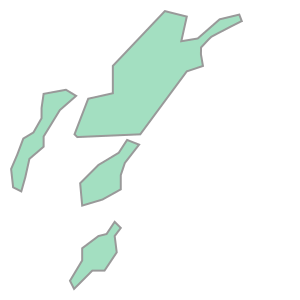

In [6]:
kommuner.geometry.iloc[0]

In [7]:
kommuner.geometry.iloc[0].wkt

'MULTIPOLYGON (((393031.1299999999 7322896.999899998, 392431.1299999999 7320196.999899998, 394231.1299999999 7320496.999899998, 396631.1299999999 7322596.999899998, 398715.13999999966 7323097.159899998, 398782.81259999983 7323113.401500002, 399005 7322534.119899999, 399056 7322399.119899999, 399001 7322382.119899999, 397822.0099999998 7321788.129900001, 396399.0099999998 7321046.149900001, 395722.0099999998 7320684.149900001, 395451.01999999955 7320425.159899998, 395380.01999999955 7320352.159899998, 394595.01999999955 7319515.1699, 394580.0099999998 7318779.1699, 394801.3744999999 7317487.0843, 393031.1299999999 7316896.999899998, 390519.1299999999 7313498.399900001, 387931.16000000015 7309996.999899998, 386897.5999999996 7309952.059900001, 381031.1900000004 7309696.999899998, 380731.1900000004 7309996.999899998, 382231.16000000015 7313896.999899998, 384931.16000000015 7314496.999899998, 384931.16000000015 7317496.999899998, 390631.1299999999 7323496.999899998, 391846.9199999999 73231

Denne kolonnen gjør det mulig å gjøre GIS.

Samle alle geometriene:

In [8]:
alt_samlet = kommuner.dissolve()
alt_samlet

,geometry,KOMMUNENR
0,"MULTIPOLYGON (((-28060.000 6510593.000, -28660...",1820


Dele opp alt som ikke overlapper (øyer deler fra fastland innad i kommunene):

In [9]:
delt_opp = alt_samlet.explode(index_parts=False)
delt_opp

,KOMMUNENR,geometry
0,1820,"POLYGON ((-28060.000 6510593.000, -28660.010 6..."
0,1820,"POLYGON ((-24383.850 6510024.560, -24848.850 6..."
0,1820,"POLYGON ((-48537.390 6585882.500, -49422.400 6..."
0,1820,"POLYGON ((-27968.180 6589899.500, -26552.980 6..."
0,1820,"POLYGON ((-25168.160 6592299.500, -26068.180 6..."
...,...,...
0,1820,"POLYGON ((823290.280 7873083.640, 824636.400 7..."
0,1820,"POLYGON ((1098151.250 7886897.000, 1097082.630..."
0,1820,"POLYGON ((822930.380 7903195.000, 826230.380 7..."
0,1820,"POLYGON ((846921.690 7911708.000, 850008.750 7..."


Bufre med 1000 meter:

In [10]:
kommuner.buffer(1000)

0      MULTIPOLYGON (((376315.112 7305086.881, 376301...
1      MULTIPOLYGON (((784248.581 7791098.288, 785431...
2      POLYGON ((258955.638 6905019.430, 258575.941 6...
3      POLYGON ((-40386.680 6759286.666, -45635.899 6...
4      POLYGON ((522971.142 7644163.102, 520219.114 7...
                             ...                        
351    POLYGON ((311999.339 6817681.105, 312841.779 6...
352    POLYGON ((95815.591 6805213.774, 95727.808 680...
353    POLYGON ((259498.824 6628998.825, 259697.602 6...
354    POLYGON ((49599.409 6517661.844, 49453.361 651...
355    POLYGON ((319949.074 6719858.678, 320913.520 6...
Length: 356, dtype: geometry

### Areal og lengde

In [11]:
kommuner.area

0      1.542645e+08
1      3.742475e+09
2      9.325153e+08
3      5.856690e+08
4      6.771995e+08
           ...     
351    1.329674e+09
352    9.724066e+08
353    9.761353e+07
354    8.933625e+08
355    1.036933e+09
Length: 356, dtype: float64

Omkrets/lengde:

In [12]:
kommuner.length

0      126623.728536
1      605644.767959
2      144895.626627
3      260175.662937
4      181307.687722
           ...      
351    180392.070296
352    164129.187065
353     50204.661912
354    126242.804001
355    166267.252014
Length: 356, dtype: float64

Gjør dette til kolonner:

In [13]:
kommuner["areal_km2"] = kommuner.area / 1_000_000
kommuner["omkrets_km"] = kommuner.length / 1_000
kommuner

,KOMMUNENR,geometry,areal_km2,omkrets_km
0,1820,"MULTIPOLYGON (((393031.130 7322897.000, 392431...",154.264453,126.623729
1,5403,"MULTIPOLYGON (((827951.920 7819380.820, 830139...",3742.475010,605.644768
2,3428,"MULTIPOLYGON (((284645.390 6883576.450, 285460...",932.515296,144.895627
3,4631,"MULTIPOLYGON (((-26068.640 6771499.000, -25768...",585.668960,260.175663
4,1871,"MULTIPOLYGON (((522790.800 7645784.410, 519366...",677.199497,181.307688
...,...,...,...,...
351,3422,"MULTIPOLYGON (((324711.900 6789915.870, 323070...",1329.673826,180.392070
352,4643,"MULTIPOLYGON (((134985.300 6829515.790, 134926...",972.406581,164.129187
353,3021,"MULTIPOLYGON (((267648.620 6616156.810, 266978...",97.613527,50.204662
354,4224,"MULTIPOLYGON (((74731.020 6533507.960, 74632.4...",893.362549,126.242804


In [14]:
kommuner.explore("areal_km2")

### Dissolve
Slå sammen kommuner til fylker:

In [15]:
kommuner["FYLKE"] = kommuner.KOMMUNENR.str[:2]

dissolvet_fylkevis = kommuner.dissolve(by="FYLKE", aggfunc="sum", as_index=False)

dissolvet_fylkevis

/home/jovyan/arealrek/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1676: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  aggregated_data = data.groupby(**groupby_kwargs).agg(aggfunc)


,FYLKE,geometry,areal_km2,omkrets_km
0,03,"POLYGON ((260144.510 6674128.710, 260144.576 6...",447.533266,102.749012
1,11,"MULTIPOLYGON (((-31360.030 6512993.000, -31660...",9064.737960,2409.416323
2,15,"MULTIPOLYGON (((60831.830 6915698.500, 61831.8...",13564.123317,3666.060141
3,18,"MULTIPOLYGON (((408459.067 7218088.531, 407669...",36298.777400,8557.362610
4,30,"MULTIPOLYGON (((219489.620 6605766.880, 219508...",24549.405915,4901.367799
5,34,"POLYGON ((289321.271 6724845.038, 288287.080 6...",52098.486046,7534.858058
6,38,"MULTIPOLYGON (((178681.720 6539094.260, 177784...",17366.955002,2923.952001
7,42,"MULTIPOLYGON (((33567.050 6461428.347, 34762.2...",16277.028900,3406.533566
8,46,"MULTIPOLYGON (((-42708.733 6633182.763, -43969...",32413.199663,7558.132572
9,50,"MULTIPOLYGON (((239231.040 6928619.440, 239187...",40995.511601,6503.652303


For de som kjenner pandas: dissolve fungerer på samme måte som groupby().agg, bare at man aggregerer geometri heller enn kolonneverdier.

In [16]:
dissolvet_fylkevis.explore("FYLKE")

### Explode (multipart to singlepart)

Del opp polygoner som ikke overlapper:

In [17]:
fylkevis_overlappende = dissolvet_fylkevis.explode(index_parts=False)
fylkevis_overlappende

,FYLKE,areal_km2,omkrets_km,geometry
0,03,447.533266,102.749012,"POLYGON ((260144.510 6674128.710, 260144.576 6..."
1,11,9064.737960,2409.416323,"POLYGON ((-31360.030 6512993.000, -31660.040 6..."
1,11,9064.737960,2409.416323,"POLYGON ((-34203.500 6518555.020, -35940.060 6..."
1,11,9064.737960,2409.416323,"POLYGON ((-48327.390 6587146.500, -47610.380 6..."
1,11,9064.737960,2409.416323,"POLYGON ((-37191.200 6593518.600, -37186.790 6..."
...,...,...,...,...
10,54,73166.673612,12125.666119,"POLYGON ((817348.770 7864403.470, 816884.590 7..."
10,54,73166.673612,12125.666119,"POLYGON ((1096972.860 7888209.210, 1096986.160..."
10,54,73166.673612,12125.666119,"POLYGON ((822030.310 7894795.000, 824430.380 7..."
10,54,73166.673612,12125.666119,"POLYGON ((850008.750 7918298.000, 853511.810 7..."


Lager ny arealkolonne og kartlegger:

In [18]:
fylkevis_overlappende["areal_km2"] = fylkevis_overlappende.area / 1_000_000

fylkevis_overlappende.explore("areal_km2")

## Punktdata

In [19]:
bygningspunktsti = "ssb-prod-kart-data-delt/kartdata_analyse/klargjorte-data/2022/SMAT_bygg_punkt_p2022_v1.parquet"

bygg = sg.read_geopandas(bygningspunktsti)

bygg

,FID_BYGG20,ID,BYGNNR,BYGSTAT,BYGTYPE,NAERING,KOMMNR,IGANGS,AREAL_E,TATTBRKD,...,AREA_AN,AREAL_E2,FYLKE,FID_ABAS_K,KNR2016,FYLKE2016,DATOMERGE,DATOKILDE,KOMMUNENR,geometry
0,2473050,0,168613636,TB,162,,4205,,87.0,,...,0.0,61.0,42,242,1002,10,,,4205,POINT (62548.000 6451031.000)
1,2473046,0,168613563,TB,161,Y,4205,,90.0,,...,90.0,90.0,42,242,1002,10,,,4205,POINT (62054.000 6451036.000)
2,3616724,0,300028178,MF,182,Y,4205,20081120,25.0,,...,25.0,25.0,42,242,1002,10,20081120,i,4205,POINT (62729.000 6451048.000)
3,281412,0,008961344,TB,161,Y,4205,19830630,90.0,19830930,...,90.0,90.0,42,242,1002,10,19830630,i,4205,POINT (62730.000 6451059.000)
4,615390,0,013882541,TB,161,Y,4205,19920515,59.0,19930620,...,59.0,59.0,42,242,1002,10,19920515,i,4205,POINT (62682.000 6451067.000)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4285302,1470760,0,141043765,TB,241,A,5419,,142.0,,...,0.0,115.0,54,862,1925,19,,,5419,POINT (620579.000 7671194.000)
4285303,3414955,0,191579100,TB,111,,5420,,87.0,,...,0.0,95.0,54,863,1926,19,,,5420,POINT (613314.000 7671207.000)
4285304,1033662,0,021728608,TB,181,Y,5419,20040920,40.0,20041220,...,40.0,40.0,54,862,1925,19,20040920,i,5419,POINT (621022.000 7671208.000)
4285305,3362949,0,190300404,TB,111,X,1871,,60.0,19131201,...,0.0,60.0,18,182,1871,18,19131201,t,1871,POINT (541968.000 7671209.000)


In [20]:
bygg.geometry

0           POINT (62548.000 6451031.000)
1           POINT (62054.000 6451036.000)
2           POINT (62729.000 6451048.000)
3           POINT (62730.000 6451059.000)
4           POINT (62682.000 6451067.000)
                        ...              
4285302    POINT (620579.000 7671194.000)
4285303    POINT (613314.000 7671207.000)
4285304    POINT (621022.000 7671208.000)
4285305    POINT (541968.000 7671209.000)
4285306    POINT (612963.000 7671211.000)
Name: geometry, Length: 4285307, dtype: geometry

In [21]:
bygg.area

0          0.0
1          0.0
2          0.0
3          0.0
4          0.0
          ... 
4285302    0.0
4285303    0.0
4285304    0.0
4285305    0.0
4285306    0.0
Length: 4285307, dtype: float64

In [22]:
bygg.length

0          0.0
1          0.0
2          0.0
3          0.0
4          0.0
          ... 
4285302    0.0
4285303    0.0
4285304    0.0
4285305    0.0
4285306    0.0
Length: 4285307, dtype: float64

Velger ut rader og kolonner. Kan gjøres samtidig inni loc, adskilt med komma.

In [23]:
rader_jeg_vil_beholde = (
    (bygg.KOMMUNENR.isin(["0301", "3401"]))
    & (bygg.DATOMERGE != " ")
)

kolonner_jeg_vil_beholde = ["DATOMERGE", "ANTBOL", "KOMMUNENR", "geometry"]

noen_bygg = bygg.loc[rader_jeg_vil_beholde, kolonner_jeg_vil_beholde]

noen_bygg

,DATOMERGE,ANTBOL,KOMMUNENR,geometry
2295777,19871001,1.0,0301,POINT (266589.000 6638437.000)
2295778,19990827,1.0,0301,POINT (266732.000 6638437.000)
2295807,19010101,1.0,0301,POINT (268630.000 6638490.000)
2295816,19971015,0.0,0301,POINT (266745.000 6638491.000)
2295817,19890901,0.0,0301,POINT (266982.000 6638491.000)
...,...,...,...,...
2829552,20010514,0.0,3401,POINT (352833.000 6693970.000)
2829566,19941222,1.0,3401,POINT (334010.000 6694055.000)
2829578,20130807,0.0,3401,POINT (334221.000 6694058.000)
2829583,19000701,1.0,3401,POINT (353355.000 6694059.000)


Legg merke til tallene helt til venstre. De beholder de samme verdiene som fra før utvelgelsen.

Dette er index-en, det viktigste konseptet i pandas.

Mer om det snart.

Lager en kolonne for år før jeg går videre.

In [24]:
noen_bygg["aar"] = noen_bygg.DATOMERGE.str[:4].astype(int)

noen_bygg

,DATOMERGE,ANTBOL,KOMMUNENR,geometry,aar
2295777,19871001,1.0,0301,POINT (266589.000 6638437.000),1987
2295778,19990827,1.0,0301,POINT (266732.000 6638437.000),1999
2295807,19010101,1.0,0301,POINT (268630.000 6638490.000),1901
2295816,19971015,0.0,0301,POINT (266745.000 6638491.000),1997
2295817,19890901,0.0,0301,POINT (266982.000 6638491.000),1989
...,...,...,...,...,...
2829552,20010514,0.0,3401,POINT (352833.000 6693970.000),2001
2829566,19941222,1.0,3401,POINT (334010.000 6694055.000),1994
2829578,20130807,0.0,3401,POINT (334221.000 6694058.000),2013
2829583,19000701,1.0,3401,POINT (353355.000 6694059.000),1900


## Spatial join

geopandas.sjoin fungerer akkurat som pandas.merge, bare at man kobler basert på geografisk overlapp heller enn kolonneverdier.

Kobler bygg med kommuner for å få kommunenummer.

In [25]:
kommuner = kommuner[["KOMMUNENR", "geometry"]]

koblet = noen_bygg.sjoin(kommuner)

koblet

,DATOMERGE,ANTBOL,KOMMUNENR_left,geometry,aar,index_right,KOMMUNENR_right
2295777,19871001,1.0,0301,POINT (266589.000 6638437.000),1987,222,0301
2295778,19990827,1.0,0301,POINT (266732.000 6638437.000),1999,222,0301
2295807,19010101,1.0,0301,POINT (268630.000 6638490.000),1901,222,0301
2295816,19971015,0.0,0301,POINT (266745.000 6638491.000),1997,222,0301
2295817,19890901,0.0,0301,POINT (266982.000 6638491.000),1989,222,0301
...,...,...,...,...,...,...,...
2756485,19010101,0.0,3401,POINT (328470.000 6682313.000),1901,295,3415
2766549,19500101,1.0,3401,POINT (329828.000 6687162.000),1950,295,3415
2694599,19010101,0.0,0301,POINT (254443.000 6672573.000),1901,235,3007
2695578,19010101,0.0,0301,POINT (254430.000 6672584.000),1901,235,3007


Byggene hadde allerede kommunenummer. Fjerner kolonnen og prøver igjen:

In [26]:
noen_bygg = noen_bygg.drop("KOMMUNENR", axis=1)

In [27]:
koblet = noen_bygg.sjoin(kommuner)
koblet

,DATOMERGE,ANTBOL,geometry,aar,index_right,KOMMUNENR
2295777,19871001,1.0,POINT (266589.000 6638437.000),1987,222,0301
2295778,19990827,1.0,POINT (266732.000 6638437.000),1999,222,0301
2295807,19010101,1.0,POINT (268630.000 6638490.000),1901,222,0301
2295816,19971015,0.0,POINT (266745.000 6638491.000),1997,222,0301
2295817,19890901,0.0,POINT (266982.000 6638491.000),1989,222,0301
...,...,...,...,...,...,...
2756485,19010101,0.0,POINT (328470.000 6682313.000),1901,295,3415
2766549,19500101,1.0,POINT (329828.000 6687162.000),1950,295,3415
2694599,19010101,0.0,POINT (254443.000 6672573.000),1901,235,3007
2695578,19010101,0.0,POINT (254430.000 6672584.000),1901,235,3007


Vi får ett bygningspunkt per overlappende kommuneflate.

In [28]:
koblet.geometry

2295777    POINT (266589.000 6638437.000)
2295778    POINT (266732.000 6638437.000)
2295807    POINT (268630.000 6638490.000)
2295816    POINT (266745.000 6638491.000)
2295817    POINT (266982.000 6638491.000)
                        ...              
2756485    POINT (328470.000 6682313.000)
2766549    POINT (329828.000 6687162.000)
2694599    POINT (254443.000 6672573.000)
2695578    POINT (254430.000 6672584.000)
2696071    POINT (254452.000 6672588.000)
Name: geometry, Length: 133933, dtype: geometry

Med motsatt rekkefølge, får man én kommuneflate per bygg i kommunen.

In [29]:
koblet_motsatt = kommuner.sjoin(noen_bygg)

koblet_motsatt.geometry

33     MULTIPOLYGON (((248135.170 6663612.850, 248657...
33     MULTIPOLYGON (((248135.170 6663612.850, 248657...
33     MULTIPOLYGON (((248135.170 6663612.850, 248657...
33     MULTIPOLYGON (((248135.170 6663612.850, 248657...
33     MULTIPOLYGON (((248135.170 6663612.850, 248657...
                             ...                        
295    MULTIPOLYGON (((324198.010 6695544.350, 325162...
295    MULTIPOLYGON (((324198.010 6695544.350, 325162...
295    MULTIPOLYGON (((324198.010 6695544.350, 325162...
295    MULTIPOLYGON (((324198.010 6695544.350, 325162...
295    MULTIPOLYGON (((324198.010 6695544.350, 325162...
Name: geometry, Length: 133933, dtype: geometry

Aggregere de koblede dataene:

In [30]:
summert_kommunevis = koblet.groupby("KOMMUNENR").agg(
    aar_mean = ("aar", "mean"),
    antall_bygg = ("aar", "count"),
)
summert_kommunevis

,aar_mean,antall_bygg
KOMMUNENR,,
0301,1963.854925,120758
3007,1931.666667,3
3020,1901.000000,1
3024,1967.006880,2471
3031,1950.962617,107
3401,1973.038755,10476
3415,1965.437500,64
3416,1953.150943,53


Legg merke til at "KOMMUNENR" ligger ett hakk lavere enn kolonnene.

Det er fordi "KOMMUNENR" blir gjort om til index etter groupby. Det samme gjelder dissolve (som gjør en groupby.agg under overflaten).

In [31]:
summert_kommunevis.index

Index(['0301', '3007', '3020', '3024', '3031', '3401', '3415', '3416'], dtype='object', name='KOMMUNENR')

In [32]:
noen_bygg.index

Int64Index([2295777, 2295778, 2295807, 2295816, 2295817, 2295824, 2295825,
            2295826, 2295827, 2296030,
            ...
            2829420, 2829423, 2829424, 2829436, 2829519, 2829552, 2829566,
            2829578, 2829583, 2829620],
           dtype='int64', length=136987)

sjoin gjør en 'inner' join som standard. 

Man kan endre til left-join hvis man vil beholde byggene som ikke overlappet med kommuner.

In [33]:
koblet_left = noen_bygg.sjoin(kommuner, how="left")
koblet_left

,DATOMERGE,ANTBOL,geometry,aar,index_right,KOMMUNENR
2295777,19871001,1.0,POINT (266589.000 6638437.000),1987,222.0,0301
2295778,19990827,1.0,POINT (266732.000 6638437.000),1999,222.0,0301
2295807,19010101,1.0,POINT (268630.000 6638490.000),1901,222.0,0301
2295816,19971015,0.0,POINT (266745.000 6638491.000),1997,222.0,0301
2295817,19890901,0.0,POINT (266982.000 6638491.000),1989,222.0,0301
...,...,...,...,...,...,...
2829552,20010514,0.0,POINT (352833.000 6693970.000),2001,144.0,3401
2829566,19941222,1.0,POINT (334010.000 6694055.000),1994,144.0,3401
2829578,20130807,0.0,POINT (334221.000 6694058.000),2013,144.0,3401
2829583,19000701,1.0,POINT (353355.000 6694059.000),1900,144.0,3401


Noen bygg ligger utenfor kommuneflatene:

In [34]:
print("antall bygg utenfor kommuneflater:", len(koblet_left) - len(koblet))

antall bygg utenfor kommuneflater: 3054


La oss finne ut hvorfor med explore. Velger noen bygg for å gjøre det raskere.

In [35]:
tilfeldige_bygg = koblet_left.sample(10_000)

For å undersøke flere GeoDataFrames samtidig og gi dem en unik farge og navn:

In [36]:
import pandas as pd

pd.concat(
    [
        kommuner.assign(hva="kommuner"),
        tilfeldige_bygg.assign(hva="tilfeldige_bygg"),
    ]
).explore("hva")

Et alternativ til geopandas' explore:

In [37]:
sg.explore(kommuner, tilfeldige_bygg)

## Spatial join nearest
sjoin_nearest kan brukes for å finne avstand til nærmeste geometri, og samtidig få kolonneinfoen.

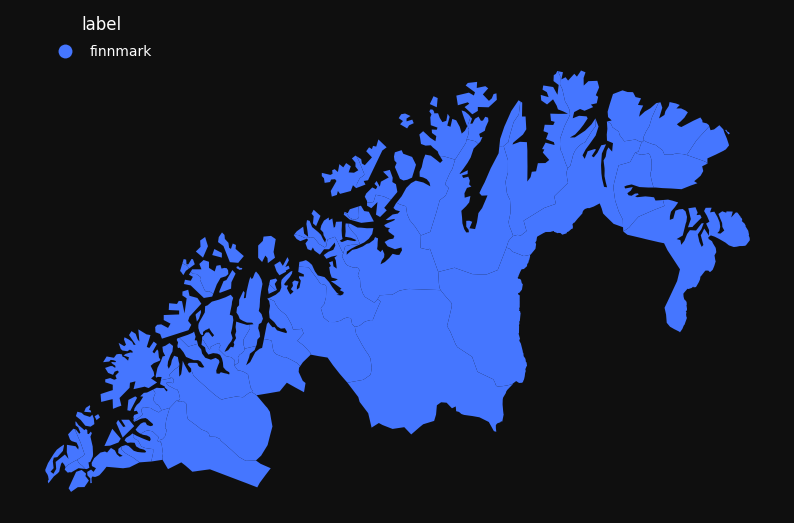

In [38]:
finnmark = kommuner.loc[kommuner.KOMMUNENR.str.startswith("54")]
sg.qtm(finnmark)

In [39]:
"5401".startswith("54"), "3401".startswith("54")

(True, False)

In [40]:
joinet = noen_bygg.sjoin_nearest(
    finnmark,
    distance_col = "meter_til_finnmark",
)

joinet

,DATOMERGE,ANTBOL,geometry,aar,index_right,KOMMUNENR,meter_til_finnmark
2295777,19871001,1.0,POINT (266589.000 6638437.000),1987,303,5412,988794.096509
2295778,19990827,1.0,POINT (266732.000 6638437.000),1999,303,5412,988753.643834
2295807,19010101,1.0,POINT (268630.000 6638490.000),1901,303,5412,988167.666063
2295816,19971015,0.0,POINT (266745.000 6638491.000),1997,303,5412,988698.171834
2295817,19890901,0.0,POINT (266982.000 6638491.000),1989,303,5412,988631.169146
...,...,...,...,...,...,...,...
2829552,20010514,0.0,POINT (352833.000 6693970.000),2001,303,5412,913588.142248
2829566,19941222,1.0,POINT (334010.000 6694055.000),1994,303,5412,917677.360961
2829578,20130807,0.0,POINT (334221.000 6694058.000),2013,303,5412,917625.637477
2829583,19000701,1.0,POINT (353355.000 6694059.000),1900,303,5412,913390.712095


In [41]:
tilfeldige_bygg = joinet.sample(10_000)
sg.explore(tilfeldige_bygg, "meter_til_finnmark")